<a href="https://colab.research.google.com/github/eoghanm2013/Enviromental-Analytics-CA2-Tornados-In-The-US/blob/main/C17426754.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***Where is the Tornado Capital of The USA?***

Author: Eoghan Mellott

Student Num: C17426754

Date: 30/04/2021


---


In this python notebook I will explore Tornado history in America and where the largest tornado hotspot is using geo-spatial data and satellite Imagery. 

Using our collection of data I will implement a Random Forest Classifier ML algorithm to see if we can predicit the magnitude of a Tornado using the data in the NOAA report of all tornados since 1950.

In [2]:
!pip install git+git://github.com/geopandas/geopandas.git

  Cloning git://github.com/geopandas/geopandas.git to /tmp/pip-req-build-g_c1za16
  Running command git clone -q git://github.com/geopandas/geopandas.git /tmp/pip-req-build-g_c1za16
     |████████████████████████████████| 15.3MB 332kB/s 
     |████████████████████████████████| 6.5MB 47.1MB/s 
  Created wheel for geopandas: filename=geopandas-0.9.0+16.gdb7366d-py2.py3-none-any.whl size=995264 sha256=674960a898aa0ba309bd6993919a61273c7fae57b3befb01df3da1b45606df6e
  Stored in directory: /tmp/pip-ephem-wheel-cache-mkm1vy18/wheels/91/24/71/376c9c67192694168352afcccc2d264248f7e2cc6192997186
Successfully built geopandas


In [3]:
!pip install rioxarray

     |████████████████████████████████| 1.1MB 16.8MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
     |████████████████████████████████| 19.1MB 244kB/s 
  Created wheel for rioxarray: filename=rioxarray-0.3.1-cp37-none-any.whl size=49120 sha256=3556414322bfcf165f45fb91b3f1d7117b884d2854e966f17f0ca2a9ef47de3e
  Stored in directory: /root/.cache/pip/wheels/67/3c/30/63d30d2f09fb6cd892948576a2866ab0cf1c5b4593cbf17fba
Successfully built rioxarray


In [4]:
!pip install rasterio
!pip install sentinelsat
!pip install mapclassify

In [5]:
# relevan imports
import pandas as pd
import numpy as np
import geopandas as gpd
import rasterio as rio
from rasterio.plot import show
from rasterio.mask import mask
import matplotlib.pyplot as plt

In [6]:
import folium

In [7]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## First I need to load in my initial datasets.

In [8]:
airports = gpd.read_file('/content/drive/MyDrive/data/bee46e1a2035499fa0aef3432c37210c.shp')

In [9]:
ok_city = gpd.read_file('/content/drive/MyDrive/data/b88c856094184488ae2f4208bc8c5c82.shp')

In [10]:
counties = gpd.read_file('/content/drive/My Drive/data/cb_2018_us_county_500k.shp')

In [11]:
states = gpd.read_file('/content/drive/My Drive/data/cb_2018_us_state_500k.shp')

In [12]:
states.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands.  British Virgin Island

In [13]:
states = states.to_crs("EPSG:3395")

## Test out our geographical data of the United states

---



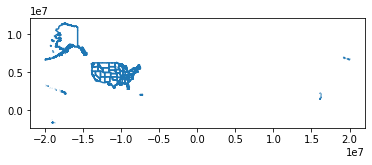

In [14]:
states.boundary.plot()

## Now load the Tornados dataset, this covers all recorded tornados from 1950 - 2019 in the US

---



In [15]:

tornados = gpd.read_file('/content/drive/My Drive/data/1950-2019-torn-aspath.shp')
# Got this data from https://www.spc.noaa.gov/gis/svrgis/

## Below are some column descriptors from the tornado dataset

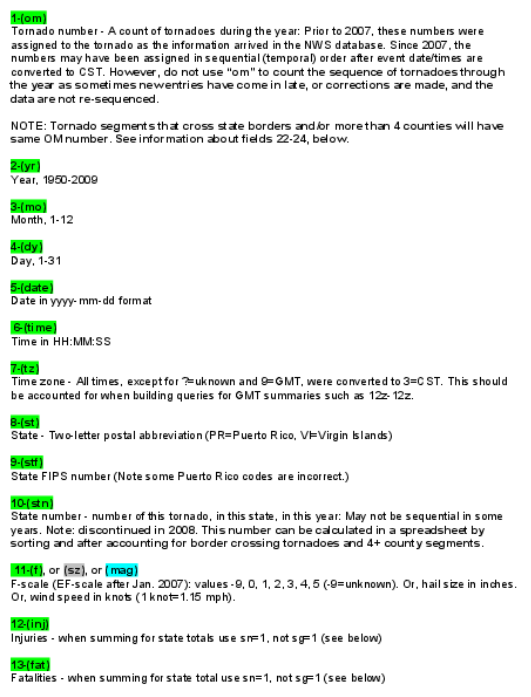

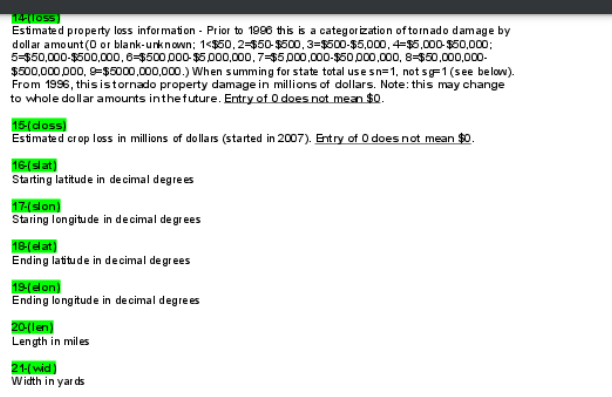

In [16]:
tornados = tornados.to_crs("EPSG:3395")

In [17]:
tornados[:1].geometry

0    LINESTRING (-10043244.459 4662018.860, -100220...
Name: geometry, dtype: geometry

## Plot our Tornados ( Contiguous United States )

---



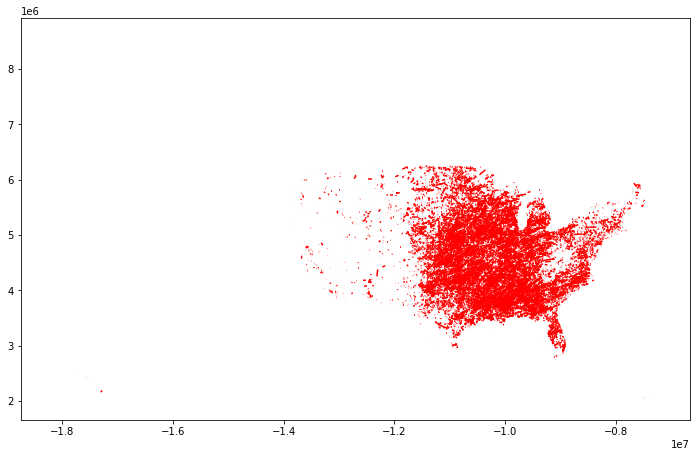

In [18]:
tornados.plot( figsize=(12,9), color='red', marker='x', markersize=1)

## Plot our Tornados on State Boundarys

---



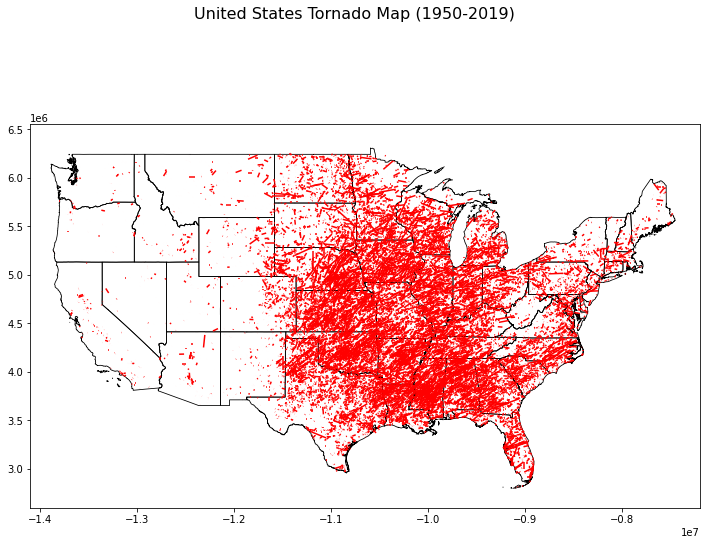

In [19]:
# I only really want to look at the contiguous states

import matplotlib.pyplot as plt
fig = plt.figure(1, figsize=(12,9)) 
ax = fig.add_subplot()

# US Lower 48 Bounding Box
# -141.00000, 26.00000, -65.50000, 72.00000

ax.set_xlim(-14100244, -7200000)
ax.set_ylim(2600000, 6550000)

fig.suptitle('United States Tornado Map (1950-2019)', fontsize=16)

states.boundary.plot(ax=ax, color='black', linewidth=.8)

tornados.plot(ax=ax, color='red', marker='t', markersize=8)

In [20]:

tor19 = tornados[tornados['yr'] == 2019]

In [21]:
tornados

,om,yr,mo,dy,date,time,tz,st,stf,stn,mag,inj,fat,loss,closs,slat,slon,elat,elon,len,wid,fc,geometry
0,1,1950,1,3,1950-01-03,11:00:00,3,MO,29,1,3,3,0,6.0,0.0,38.7700,-90.2200,38.8300,-90.0300,9.50,150,0,"LINESTRING (-10043244.459 4662018.860, -100220..."
1,2,1950,1,3,1950-01-03,11:55:00,3,IL,17,2,3,3,0,5.0,0.0,39.1000,-89.3000,39.1200,-89.2300,3.60,130,0,"LINESTRING (-9940830.528 4709053.526, -9933038..."
2,3,1950,1,3,1950-01-03,16:00:00,3,OH,39,1,1,1,0,4.0,0.0,40.8800,-84.5800,40.8801,-84.5799,0.10,10,0,"LINESTRING (-9415402.531 4966686.373, -9415391..."
3,4,1950,1,13,1950-01-13,05:25:00,3,AR,5,1,3,1,1,3.0,0.0,34.4000,-94.3700,34.4001,-94.3699,0.60,17,0,"LINESTRING (-10505220.346 4058499.570, -105052..."
4,5,1950,1,25,1950-01-25,19:30:00,3,MO,29,2,2,5,0,5.0,0.0,37.6000,-90.6800,37.6300,-90.6500,2.30,300,0,"LINESTRING (-10094451.425 4496998.866, -100911..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65157,618537,2019,12,29,2019-12-29,16:03:00,3,MS,28,0,1,0,0,75000.0,0.0,33.1628,-89.4323,33.2339,-89.3298,7.70,900,0,"LINESTRING (-9955558.096 3893560.843, -9944147..."
65158,618538,2019,12,29,2019-12-29,16:13:00,3,MS,28,0,1,0,0,10000.0,0.0,33.2598,-89.2778,33.2879,-89.2208,3.82,200,0,"LINESTRING (-9938359.235 3906406.370, -9932014..."
65159,618539,2019,12,29,2019-12-29,16:32:00,3,MS,28,0,0,0,0,5000.0,0.0,33.4720,-89.0315,33.4888,-88.9910,2.61,200,0,"LINESTRING (-9910941.245 3934557.939, -9906432..."
65160,618540,2019,12,29,2019-12-29,17:13:00,3,MS,28,0,1,0,0,150000.0,0.0,32.5268,-89.1628,32.5581,-89.1215,3.23,125,0,"LINESTRING (-9925557.494 3809688.591, -9920959..."


## What state gets hit by the most tornados?

---



In [22]:
# I want to see what state gets git worst by Tornados

torcount = tornados
torcount['c'] = 1
torcount = torcount[['st','c']].groupby('st').count()
torcount = torcount.sort_values('st', ascending=True)

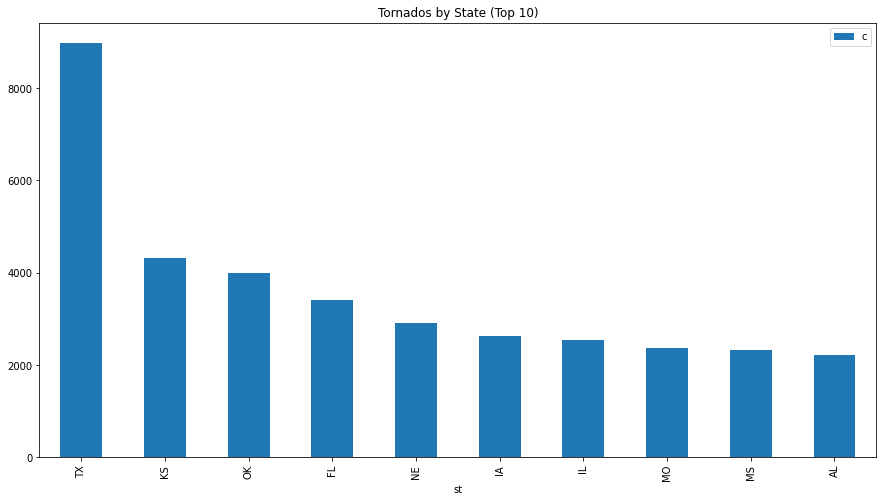

In [23]:
torcount.sort_values('c', ascending=False)[:10].plot.bar(figsize=(15,8), title='Tornados by State (Top 10)')


In [24]:
t = pd.merge(states, torcount, left_on ='STUSPS', right_on ='st')
t

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry,c
0,28,01779790,0400000US28,28,MS,Mississippi,00,121533519481,3926919758,"MULTIPOLYGON (((-9852105.109 3509746.658, -985...",2319
1,37,01027616,0400000US37,37,NC,North Carolina,00,125923656064,13466071395,"MULTIPOLYGON (((-8429869.595 4266719.539, -842...",1366
2,40,01102857,0400000US40,40,OK,Oklahoma,00,177662925723,3374587997,"POLYGON ((-11466193.086 4347889.504, -11466151...",3990
3,51,01779803,0400000US51,51,VA,Virginia,00,102257717110,8528531774,"MULTIPOLYGON (((-8431606.067 4526190.756, -843...",761
4,54,01779805,0400000US54,54,WV,West Virginia,00,62266474513,489028543,"POLYGON ((-9199798.730 4576931.130, -9199776.3...",141
5,22,01629543,0400000US22,22,LA,Louisiana,00,111897594374,23753621895,"MULTIPOLYGON (((-9892707.112 3464494.705, -989...",2132
6,26,01779789,0400000US26,26,MI,Michigan,00,146600952990,103885855702,"MULTIPOLYGON (((-9260845.548 5137660.465, -926...",1051
7,25,00606926,0400000US25,25,MA,Massachusetts,00,20205125364,7129925486,"MULTIPOLYGON (((-7818419.128 5026367.239, -781...",171
8,16,01779783,0400000US16,16,ID,Idaho,00,214049787659,2391722557,"POLYGON ((-13051394.880 5497110.537, -13050522...",218
9,12,00294478,0400000US12,12,FL,Florida,00,138949136250,31361101223,"MULTIPOLYGON (((-8925182.218 2921968.470, -892...",3406


## Chloropleth Map of Tornados in the USA by Tornados per state

---



In [25]:
# Chloropleth Map of Tornados in the USA by Tornados per state
import pandas as pd

#topstate= top.merge(states, left_on='st', right_on='STUSPS')
# Centre 39°50′N 98°35′W,

f = folium.Figure(width=800, height=600)
m = folium.Map(location=[36.084621, -96.921387], zoom_start=4)

folium.Choropleth(
    geo_data=t,
    data=t,
    columns = ['NAME', 'c'],
    fill_color="YlOrRd",
    key_on="feature.properties.NAME",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Tornados by State",
    highlight = True
).add_to(m)

folium.LayerControl().add_to(m)

f.add_child(m)

## Although Texas has more tornados than any other state, it also comes with a massive land area. To find the real tornado capital of the USA I will find Tornados per 10,000 Sq Miles.


---



In [26]:
import pandas as pd
area = pd.read_csv('/content/drive/My Drive/data/state-areas.csv')
abb = pd.read_csv('/content/drive/My Drive/data/state-abbrevs.csv')

areas = pd.merge(area, abb, on="state")

In [27]:
torcount = torcount.reset_index()
areas = pd.merge(areas, torcount, left_on='abbreviation', right_on='st')
areas.head()

,state,area (sq. mi),abbreviation,st,c
0,Alabama,52423,AL,AL,2223
1,Alaska,656425,AK,AK,4
2,Arizona,114006,AZ,AZ,262
3,Arkansas,53182,AR,AR,1838
4,California,163707,CA,CA,450


In [28]:
areas.rename(columns={'area (sq. mi)': 'area'}, inplace=True)

In [29]:
tor10 = []
for i in range(len(areas)):
  #print(areas.iloc[i])
  tor10.append((areas.iloc[i].c / areas.iloc[i].area) * 10000)
  


In [30]:
areas['tor10'] = tor10
areas
tpm = pd.merge(areas, states, left_on='state', right_on='NAME')

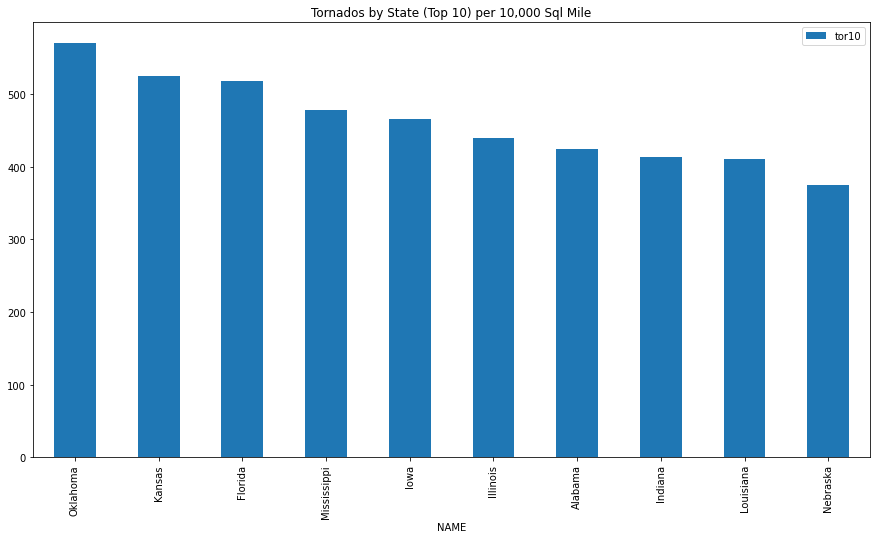

In [31]:
tcount = tpm[['NAME', 'tor10']]
tcount.set_index('NAME', inplace=True)
tcount.sort_values('tor10', ascending=False)[:10].plot.bar(figsize=(15,8), title='Tornados by State (Top 10) per 10,000 Sq Mile')


## Chloropleth Map of Tornados in the USA by Tornados per state per 10,000 Sq Miles

In [32]:
# Chloropleth Map of Tornados in the USA by Tornados per state
import pandas as pd
t = tpm
#topstate= top.merge(states, left_on='st', right_on='STUSPS')
# Centre 39°50′N 98°35′W,

f = folium.Figure(width=800, height=600)
m = folium.Map(location=[36.084621, -96.921387], zoom_start=4)

folium.Choropleth(
    geo_data=states,
    data=t,
    columns = ['NAME', 'tor10'],
    fill_color="YlOrRd",
    key_on="feature.properties.NAME",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Tornados by State",
    highlight = True
).add_to(m)

folium.LayerControl().add_to(m)

f.add_child(m)

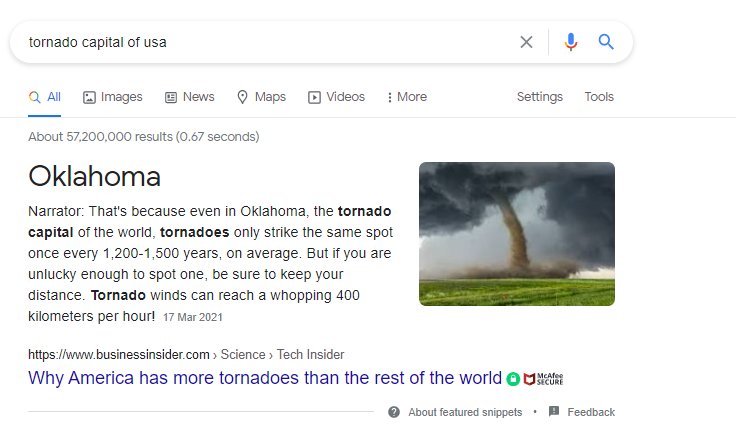

## Lets take a closer look at Oklahoma

---



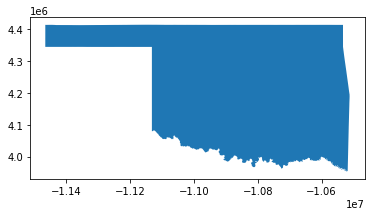

In [33]:
ok_map = states[states['NAME'] == 'Oklahoma']
ok_map.plot()

In [34]:
counties = counties.to_crs("EPSG:3395")
#State FP code 40 is Oklahoma
countiesOK = counties[counties['STATEFP']  == '40']

In [35]:
torOK = tornados[tornados['st'] == 'OK']
torOK

,om,yr,mo,dy,date,time,tz,st,stf,stn,mag,inj,fat,loss,closs,slat,slon,elat,elon,len,wid,fc,geometry,c
26,27,1950,2,27,1950-02-27,10:20:00,3,OK,40,1,2,0,0,4.0,0.0,35.5500,-97.6000,35.5501,-97.5999,2.0,50,0,"LINESTRING (-10864782.301 4214033.687, -108647...",1
37,38,1950,3,27,1950-03-27,03:00:00,3,OK,40,2,2,0,0,3.0,0.0,34.8500,-95.7500,34.8501,-95.7499,0.1,77,0,"LINESTRING (-10658841.243 4119098.851, -106588...",1
49,50,1950,4,2,1950-04-02,18:00:00,3,OK,40,3,2,0,0,4.0,0.0,35.8200,-97.0200,35.8201,-97.0199,1.0,100,0,"LINESTRING (-10800216.997 4250874.289, -108002...",1
51,52,1950,4,3,1950-04-03,16:15:00,3,OK,40,4,1,0,0,3.0,0.0,36.1300,-95.8300,36.1301,-95.8299,1.0,33,0,"LINESTRING (-10667746.803 4293329.016, -106677...",1
56,57,1950,4,28,1950-04-28,14:17:00,3,OK,40,5,3,1,1,5.0,0.0,34.8800,-99.2800,35.1700,-99.2000,20.8,400,0,"LINESTRING (-11051799.046 4123150.644, -110428...",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65053,618433,2019,10,20,2019-10-20,22:08:00,3,OK,40,0,1,0,0,10000.0,0.0,35.9436,-95.5608,35.9928,-95.4469,7.2,1100,0,"LINESTRING (-10637779.596 4267781.248, -106251...",1
65054,618434,2019,10,20,2019-10-20,22:12:00,3,OK,40,0,0,0,0,2000.0,0.0,35.6351,-95.6311,35.7161,-95.5232,8.3,400,0,"LINESTRING (-10645605.356 4225631.735, -106335...",1
65055,618435,2019,10,20,2019-10-20,22:39:00,3,OK,40,0,1,0,0,0.0,0.0,36.1189,-94.9665,36.1211,-94.9143,2.9,600,0,"LINESTRING (-10571622.422 4291805.952, -105658...",1
65056,618436,2019,10,20,2019-10-20,23:00:00,3,OK,40,0,1,0,0,225000.0,0.0,36.1410,-94.6644,36.1666,-94.5045,9.1,900,0,"LINESTRING (-10537992.804 4294838.572, -105201...",1


## Oklahoma Tornados Paths & country boundaries

---



(3830000.0, 4700000.0)

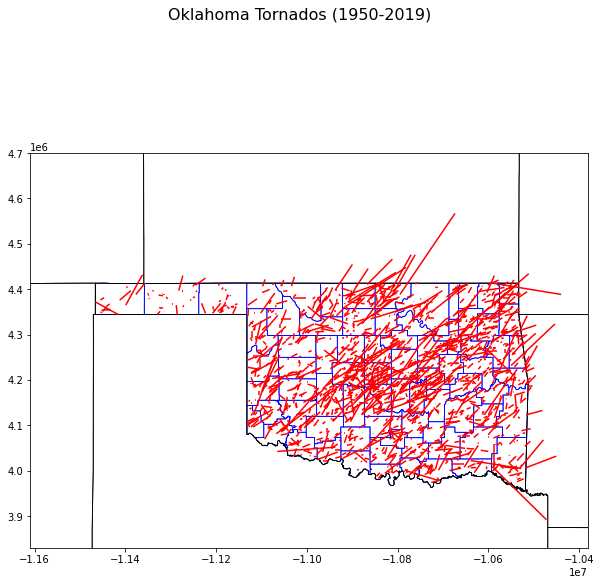

In [36]:
import matplotlib.pyplot as plt
fig = plt.figure(1, figsize=(10,10)) 
ax = fig.add_subplot()


fig.suptitle('Oklahoma Tornados (1950-2019)', fontsize=16)
countiesOK.boundary.plot(ax=ax, color='blue', linewidth=.8)
states.boundary.plot(ax=ax, color='black', linewidth=.8)
torOK.plot(ax=ax, color='red', marker='v', markersize=20)
ax.set_xlim(-11610000, -10380000)
ax.set_ylim(3830000, 4700000)

## Lets gather some more information on Oklahoma

---



In [37]:
ok_city = counties[counties['NAME'] == 'Oklahoma']
pois = gpd.read_file('/content/drive/MyDrive/data/oklahoma/gis_osm_pois_a_free_1.shp')
buildings = gpd.read_file('/content/drive/MyDrive/data/oklahoma/gis_osm_buildings_a_free_1.shp')

In [38]:
torOK=torOK.to_crs(pois.crs)
torlast10 = torOK[torOK['yr'] > 2008]
torlast10=torlast10.to_crs(pois.crs)

In [39]:
tor19.crs

<Projected CRS: EPSG:3395>
Name: WGS 84 / World Mercator
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: World between 80°S and 84°N.
- bounds: (-180.0, -80.0, 180.0, 84.0)
Coordinate Operation:
- name: World Mercator
- method: Mercator (variant A)
Datum: World Geodetic System 1984
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

## Recorded Buildings and POIS of Oklahoma City

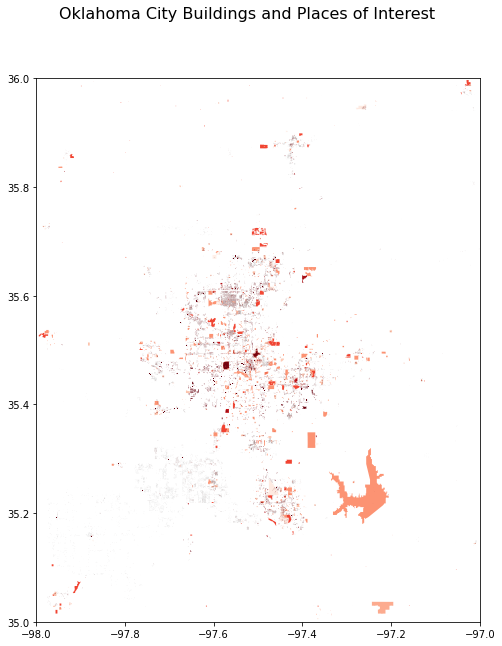

In [40]:
fig, ax = plt.subplots(figsize=(12,10))
plt.xlim(-98,-97)
plt.ylim(35,36)

pois = pois.to_crs("EPSG:4326")
buildings = buildings.to_crs("EPSG:4326")
fig.suptitle('Oklahoma City Buildings and Places of Interest', fontsize=16)
pois.plot(column="fclass", ax=ax, cmap="Reds_r" )
buildings.plot(column="fclass", ax=ax, cmap="Reds_r")

In [41]:
# Lets Look at the Strong to Violent Tornados only

torbig = torlast10[torlast10['mag'] >= 3]


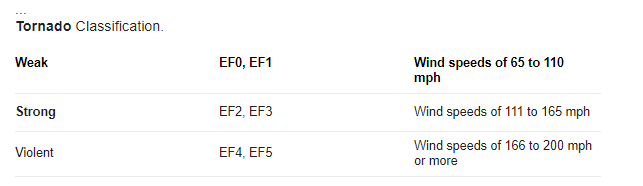

# Interactive Okloahoma City Tornado Folium Map - Click the colour coded circle markers for information on the Tornado

---



In [48]:


import folium
myscale = (torbig['mag'].quantile((0,.1,.2,.3,.4,1))).tolist()



f = folium.Figure(width=1200, height=1200)
m = folium.Map(location=[35.4676, -97.5164],  zoom_start=10, tiles='stamenterrain')

colordict = {3: 'yellow', 4: 'orange',  5: 'red'}

#folium.CircleMarker([torlast10['slat'],torlast10['slon']], radius=1, color='white').add_to(m)

for i in range(0,len(torbig)):
   folium.CircleMarker(
      location=[torbig.iloc[i]['slat'],torbig.iloc[i]['slon']],
      popup="Date:{}\n Magnitude:{}\n Fatalities:{}\n Injured:{}".format(torbig.iloc[i].date, torbig.iloc[i].mag, torbig.iloc[i].fat, torbig.iloc[i].inj),
      radius=3*(int(torbig.iloc[i].mag)),
      fill_color=colordict[torbig.iloc[i].mag],
      fill=True,
      fill_opacity=0.7
   ).add_to(m)

folium.Choropleth(
    torbig,
    line_weight=5,
    threshold_scale=myscale,
    line_color='red',
    line_opacity=.5
).add_to(m)

f.add_child(m)

# ***Lets Take a Look at some Satellite Imagery***

In [43]:
# The data provided here describes an area in Oklahoma
b = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_TCI.jp2")# natural
b8a = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B8A.jp2") 
b12 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B12.jp2") 
b11 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B11.jp2") 
b10 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B10.jp2")
b9 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B09.jp2") 
b8 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B08.jp2") 
b7 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B07.jp2")
b6 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B06.jp2") 
b5 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B05.jp2")
b4 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B04.jp2") 
b3 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B03.jp2") 
b2 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B02.jp2") 
b1 = rio.open("/content/drive/MyDrive/data/T14SPE_20210419T170851_B01.jp2") 

Text(0.5, 1.0, 'Blue')

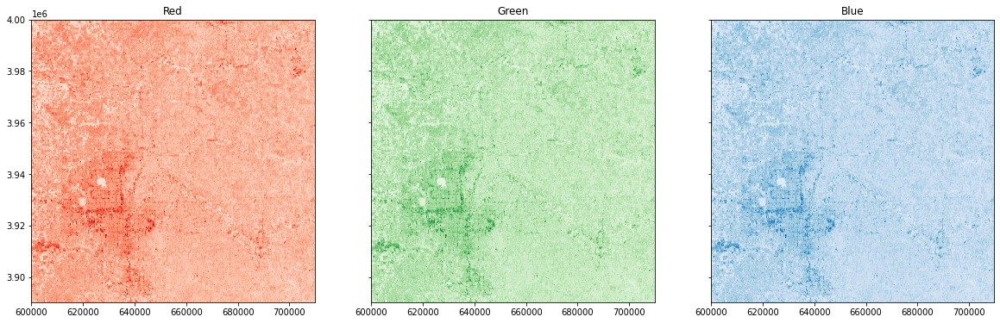

In [49]:
# display the different layers side by side
%matplotlib inline

# Initialize subplots
fig, (ax1, ax2, ax3) = plt.subplots(ncols=3, nrows=1, figsize=(20, 10), sharey=True)

# Plot Red, Green and Blue (rgb)
show((b, 1), cmap='Reds', ax=ax1)
show((b, 1), cmap='Greens', ax=ax2)
show((b, 1), cmap='Blues', ax=ax3)

# Add titles
ax1.set_title("Red")
ax2.set_title("Green")
ax3.set_title("Blue")

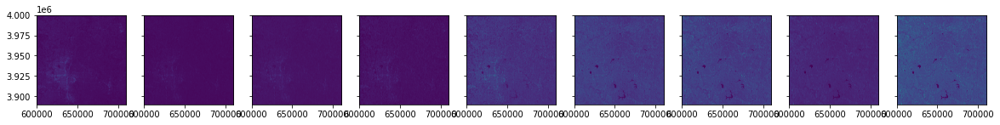

In [51]:
# display the different layers side by side
%matplotlib inline

# Initialize subplots
fig, (ax1, ax2, ax3, ax4, ax5, ax6, ax7, ax8, ax9) = plt.subplots(ncols=9, nrows=1, figsize=(20, 10), sharey=True)


show((b1, 1), ax=ax1)
show((b2, 1), ax=ax2)
show((b3, 1), ax=ax3)
show((b4, 1), ax=ax4)
show((b5, 1), ax=ax5)
show((b6, 1), ax=ax6)
show((b7, 1), ax=ax7)
show((b8, 1), ax=ax8)
show((b8a, 1), ax=ax9)



In [52]:
# RGB  images are made up of bands 2, 3, and 4. The band 'b' has them layered on eachother to produce the normal image

import rioxarray as rxr
band = rxr.open_rasterio(b, masked=True)
band

<xarray.DataArray (band: 3, y: 10980, x: 10980)>
[361681200 values with dtype=float64]
Coordinates:
  * band         (band) int64 1 2 3
  * y            (y) float64 4e+06 4e+06 4e+06 ... 3.89e+06 3.89e+06 3.89e+06
  * x            (x) float64 6e+05 6e+05 6e+05 ... 7.098e+05 7.098e+05 7.098e+05
    spatial_ref  int64 0
Attributes:
    scale_factor:  1.0
    add_offset:    0.0
    grid_mapping:  spatial_ref

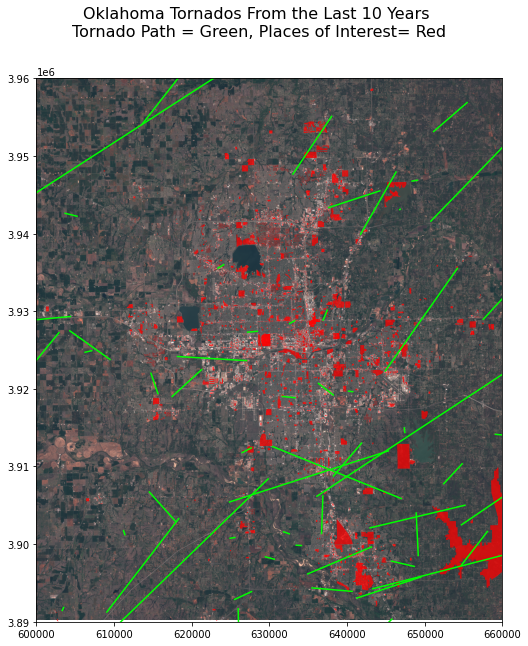

In [53]:
buildings = buildings.to_crs(b.crs)
pois = pois.to_crs(b.crs)
tor = torlast10.to_crs(b.crs)
# Let's overlay the information
fig, ax = plt.subplots(figsize=(12, 10))
plt.xlim(600000,660000)
plt.ylim(3890000,3960000)
fig.suptitle('Oklahoma Tornados From the Last 10 Years \nTornado Path = Green, Places of Interest= Red', fontsize=16)
show(b, ax=ax) #b4 is the red band
buildings.plot(ax=ax, color="red", alpha=.75)
pois.plot(ax=ax, color="red", alpha=.75)
tor.plot(ax=ax, color="lime", alpha=1)
plt.show();

In [54]:
## What was Oklahomas Worst Tornado
torlast10=torlast10.sort_values('fat', ascending=False)
torlast10
moore = torlast10[torlast10['om'] == 451537]

## What was Oklahoma's Worst Tornado?

In [55]:
moore

,om,yr,mo,dy,date,time,tz,st,stf,stn,mag,inj,fat,loss,closs,slat,slon,elat,elon,len,wid,fc,geometry,c
57452,451537,2013,5,20,2013-05-20,13:56:00,3,OK,40,0,5,212,24,2000.0,0.0,35.284,-97.628,35.341,-97.3999,13.85,1900,0,"LINESTRING (-97.62800 35.28400, -97.39990 35.3...",1


# As you can tell the dataset must be incorrect as the loss value is the property damage but it only equals $2000. If it injured 212 people and killed 24 it must be higher

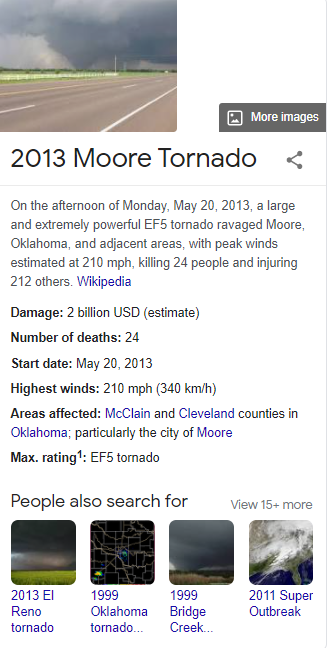

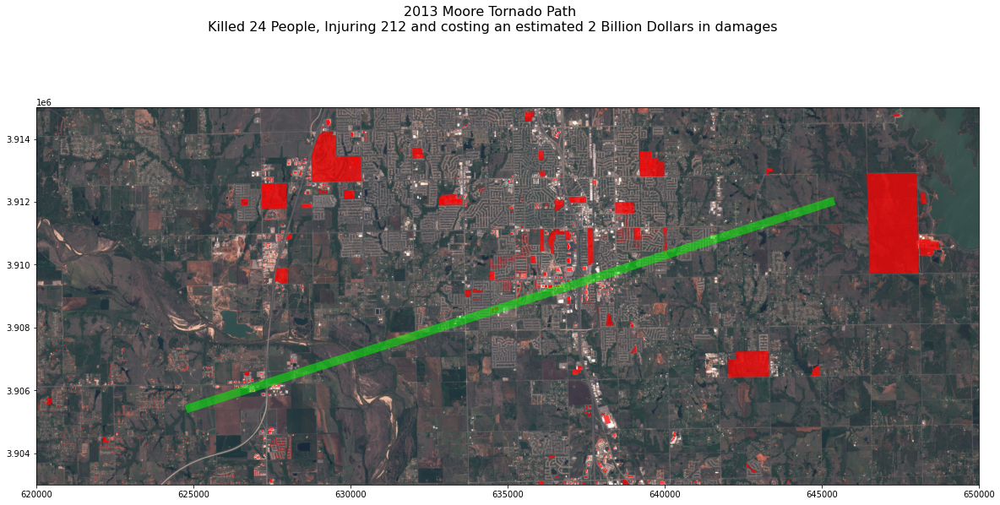

In [56]:
buildings = buildings.to_crs(b.crs)

pois = pois.to_crs(b.crs)
moore =  moore.to_crs(b.crs)
# Let's overlay the information
fig, ax = plt.subplots(figsize=(20, 10))
plt.xlim(620000,650000)
plt.ylim(3903000,3915000)
fig.suptitle('2013 Moore Tornado Path \nKilled 24 People, Injuring 212 and costing an estimated 2 Billion Dollars in damages', fontsize=16)
show(b, ax=ax) #b4 is the red band
buildings.plot(ax=ax, color="red", alpha=.75)
pois.plot(ax=ax, color="red", alpha=.75)
moore.plot(ax=ax, color="lime", alpha=.5, linewidth=10)
plt.show();

## Sentinel Satellites didnt come about until 2015 so Im going to just grab some images of the aftermath from google.
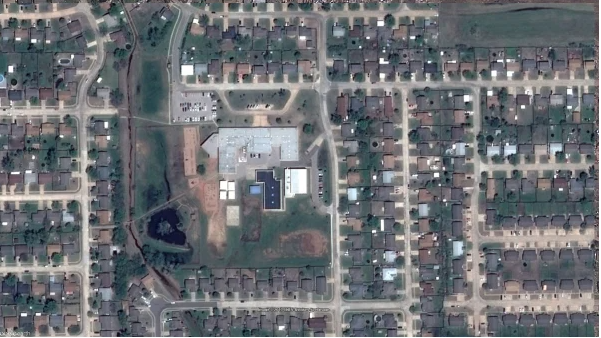

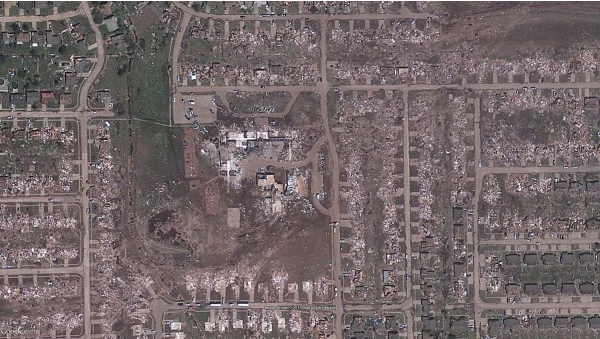

# I wonder can I use machine learning to guess the magnitude using the witdth and length of the tornado path



---




In [57]:
tornados = tornados[tornados.mag != 0]
tornados = tornados[tornados.mag != -9]

tor_feat = tornados[['yr','mo','dy','inj','fat','len','wid','mag','loss','closs','stf','slon','slat']]
tor_target = tornados[['mag']]
tornados

,om,yr,mo,dy,date,time,tz,st,stf,stn,mag,inj,fat,loss,closs,slat,slon,elat,elon,len,wid,fc,geometry,c
0,1,1950,1,3,1950-01-03,11:00:00,3,MO,29,1,3,3,0,6.0,0.0,38.7700,-90.2200,38.8300,-90.0300,9.50,150,0,"LINESTRING (-10043244.459 4662018.860, -100220...",1
1,2,1950,1,3,1950-01-03,11:55:00,3,IL,17,2,3,3,0,5.0,0.0,39.1000,-89.3000,39.1200,-89.2300,3.60,130,0,"LINESTRING (-9940830.528 4709053.526, -9933038...",1
2,3,1950,1,3,1950-01-03,16:00:00,3,OH,39,1,1,1,0,4.0,0.0,40.8800,-84.5800,40.8801,-84.5799,0.10,10,0,"LINESTRING (-9415402.531 4966686.373, -9415391...",1
3,4,1950,1,13,1950-01-13,05:25:00,3,AR,5,1,3,1,1,3.0,0.0,34.4000,-94.3700,34.4001,-94.3699,0.60,17,0,"LINESTRING (-10505220.346 4058499.570, -105052...",1
4,5,1950,1,25,1950-01-25,19:30:00,3,MO,29,2,2,5,0,5.0,0.0,37.6000,-90.6800,37.6300,-90.6500,2.30,300,0,"LINESTRING (-10094451.425 4496998.866, -100911...",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65155,618535,2019,12,29,2019-12-29,15:35:00,3,MS,28,0,1,0,0,29000.0,0.0,32.8795,-89.8075,32.9380,-89.7029,7.34,400,0,"LINESTRING (-9997325.169 3856125.786, -9985681...",1
65156,618536,2019,12,29,2019-12-29,15:53:00,3,MS,28,0,1,0,0,10000.0,0.0,33.0978,-89.5429,33.1410,-89.4411,6.60,500,0,"LINESTRING (-9967870.032 3884961.042, -9956537...",1
65157,618537,2019,12,29,2019-12-29,16:03:00,3,MS,28,0,1,0,0,75000.0,0.0,33.1628,-89.4323,33.2339,-89.3298,7.70,900,0,"LINESTRING (-9955558.096 3893560.843, -9944147...",1
65158,618538,2019,12,29,2019-12-29,16:13:00,3,MS,28,0,1,0,0,10000.0,0.0,33.2598,-89.2778,33.2879,-89.2208,3.82,200,0,"LINESTRING (-9938359.235 3906406.370, -9932014...",1


## Check the correlations between our variables.

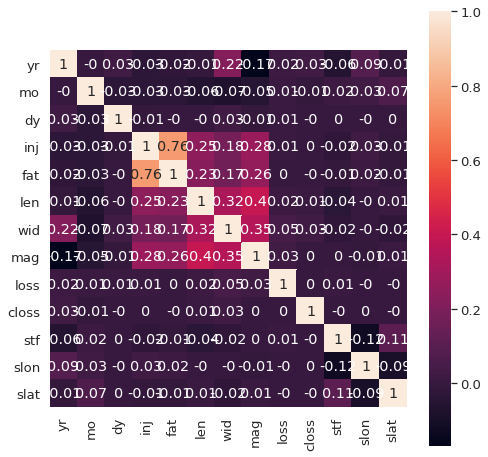

In [58]:
#tor_feat.corr()
import seaborn as sns
# Heatmap for easier interpretation:
plt.figure(figsize=(8,8))
sns.set(font_scale=1.2)
sns.heatmap(tor_feat.corr().round(2), square=True, annot=True)
plt.show()

## Get a few  Imports from Sci-kit Learn for some predictive analytics

In [59]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

In [60]:
# Split dataset into features and target
y = tor_feat['mag']
X = tor_feat.drop('mag', axis=1)

In [61]:

# Split features and target into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=1, stratify=y)

In [62]:
# Instantiate and fit the RandomForestClassifier
forest = RandomForestClassifier()
forest.fit(X_train, y_train)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='auto',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, n_estimators=100,
                       n_jobs=None, oob_score=False, random_state=None,
                       verbose=0, warm_start=False)

In [63]:
# Make predictions for the test set
y_pred_test = forest.predict(X_test)

In [64]:
# View accuracy score
accuracy_score(y_test, y_pred_test)

0.7191375912831807

## After Messing Around with Feature selection We can predict the magnitude of a tornado to 71% to 72% Accuracy

In [65]:
# View the classification report for test data and predictions
print(classification_report(y_test, y_pred_test))

              precision    recall  f1-score   support

           1       0.79      0.90      0.84      5514
           2       0.53      0.44      0.48      2331
           3       0.50      0.28      0.36       624
           4       0.58      0.27      0.37       143
           5       1.00      0.13      0.24        15

    accuracy                           0.72      8627
   macro avg       0.68      0.40      0.46      8627
weighted avg       0.70      0.72      0.70      8627



# Confusion Matrix can tell us more about our accuracy and predictions. Mag1 is almost always correct & Mag5 is frequently classified as a Mag4

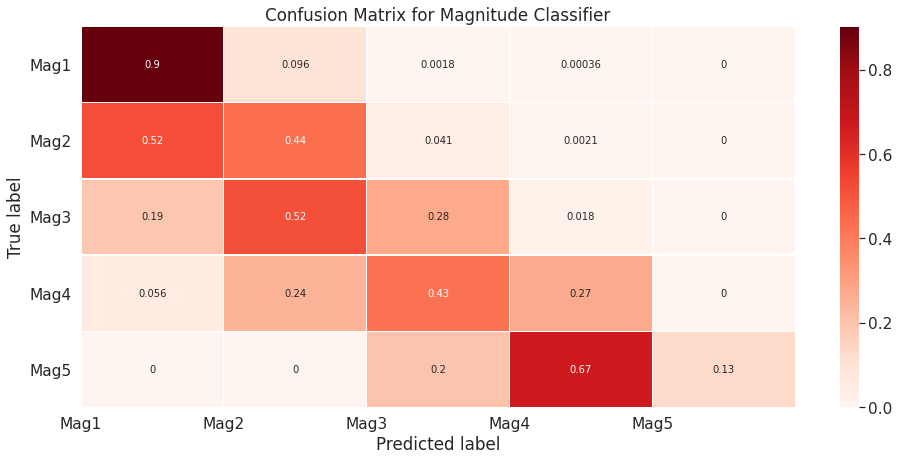

In [66]:
# Get and reshape confusion matrix data
matrix = confusion_matrix(y_test, y_pred_test)
matrix = matrix.astype('float') / matrix.sum(axis=1)[:, np.newaxis]

# Build the plot
plt.figure(figsize=(16,7))
sns.set(font_scale=1.4)
sns.heatmap(matrix, annot=True, annot_kws={'size':10},
            cmap=plt.cm.Reds, linewidths=0.2)

# Add labels to the plot
class_names = ['Mag1','Mag2','Mag3','Mag4','Mag5']
tick_marks = np.arange(len(class_names))
tick_marks2 = tick_marks + 0.5
plt.xticks(tick_marks, class_names)
plt.yticks(tick_marks2, class_names, rotation=0)
plt.xlabel('Predicted label')
plt.ylabel('True label')
plt.title('Confusion Matrix for Magnitude Classifier')
plt.show()

In [67]:
# View the classification report for test data and predictions
print(classification_report(y_test, y_pred_test))

              precision    recall  f1-score   support

           1       0.79      0.90      0.84      5514
           2       0.53      0.44      0.48      2331
           3       0.50      0.28      0.36       624
           4       0.58      0.27      0.37       143
           5       1.00      0.13      0.24        15

    accuracy                           0.72      8627
   macro avg       0.68      0.40      0.46      8627
weighted avg       0.70      0.72      0.70      8627

